In [1]:
#necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px 
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import numpy as np

In [2]:
# Loading dataset
temperature = pd.read_csv('temperature.csv')

In [3]:

print(temperature.shape)

(45253, 37)


In [4]:

temperature.head()


,datetime,Vancouver,Portland,San Francisco,Seattle,Los Angeles,San Diego,Las Vegas,Phoenix,Albuquerque,...,Philadelphia,New York,Montreal,Boston,Beersheba,Tel Aviv District,Eilat,Haifa,Nahariyya,Jerusalem
0,2012-10-01 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,309.100000,NaN,NaN,NaN
1,2012-10-01 13:00:00,284.630000,282.080000,289.480000,281.800000,291.870000,291.530000,293.410000,296.600000,285.120000,...,285.630000,288.220000,285.830000,287.170000,307.590000,305.470000,310.580000,304.4,304.4,303.5
2,2012-10-01 14:00:00,284.629041,282.083252,289.474993,281.797217,291.868186,291.533501,293.403141,296.608509,285.154558,...,285.663208,288.247676,285.834650,287.186092,307.590000,304.310000,310.495769,304.4,304.4,303.5
3,2012-10-01 15:00:00,284.626998,282.091866,289.460618,281.789833,291.862844,291.543355,293.392177,296.631487,285.233952,...,285.756824,288.326940,285.847790,287.231672,307.391513,304.281841,310.411538,304.4,304.4,303.5
4,2012-10-01 16:00:00,284.624955,282.100481,289.446243,281.782449,291.857503,291.553209,293.381213,296.654466,285.313345,...,285.850440,288.406203,285.860929,287.277251,307.145200,304.238015,310.327308,304.4,304.4,303.5


## Data Preprocessing

In [5]:
##Checking for missing values in each dataset:

In [6]:
print(temperature.isnull().sum())


datetime               0
Vancouver            795
Portland               1
San Francisco        793
Seattle                3
Los Angeles            3
San Diego              1
Las Vegas              1
Phoenix                3
Albuquerque            1
Denver                 1
San Antonio            1
Dallas                 4
Houston                3
Kansas City            1
Minneapolis           13
Saint Louis            1
Chicago                3
Nashville              2
Indianapolis           7
Atlanta                6
Detroit                1
Jacksonville           1
Charlotte              3
Miami                805
Pittsburgh             3
Toronto                1
Philadelphia           3
New York             793
Montreal               3
Boston                 3
Beersheba            798
Tel Aviv District    793
Eilat                792
Haifa                798
Nahariyya            797
Jerusalem            793
dtype: int64


In [7]:
#Handling missing values
# Example: filling missing values with the mean
temperature.fillna(temperature.mean(), inplace=True)

C:\Users\mdipa\AppData\Local\Temp\ipykernel_17060\2871458767.py:3: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  temperature.fillna(temperature.mean(), inplace=True)


## Exploratory Data Analysis (EDA)

In [8]:
temperature['datetime'] = pd.to_datetime(temperature['datetime'])
temperature['year'] = temperature['datetime'].dt.year

In [9]:
city_columns = temperature.columns[2:7]

# Create scatter plots for the first 5 cities
for city in city_columns:
    fig = px.scatter(temperature, x='datetime', y=city, color='year',
                     title=f'Temperature Scatter Plot for {city}',
                     labels={'datetime': 'Date', city: 'Temperature'})
    fig.show()

In [10]:
for city in city_columns:
    fig = px.histogram(temperature, x=city, color='year', 
                       title=f'Temperature Histogram for {city}',
                       labels={city: 'Temperature'})
    fig.show()

In [11]:
from prophet import Prophet
city = 'Portland'
df = temperature[['datetime', city]].rename(columns={'datetime': 'ds', city: 'y'})
df.dropna(inplace=True)
df.head()

,ds,y
0,2012-10-01 12:00:00,284.992929
1,2012-10-01 13:00:00,282.080000
2,2012-10-01 14:00:00,282.083252
3,2012-10-01 15:00:00,282.091866
4,2012-10-01 16:00:00,282.100481


In [12]:
# Initializing the Prophet model
model = Prophet()
model.fit(df)


21:27:56 - cmdstanpy - INFO - Chain [1] start processing
21:28:45 - cmdstanpy - INFO - Chain [1] done processing


## Make future predictions

In [13]:
# Creating a dataframe for future dates (e.g., predict for the next 365 days)
future = model.make_future_dataframe(periods=365)

# predictions
forecast = model.predict(future)

# Displaying the forecast
print(forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail())


              ds        yhat  yhat_lower  yhat_upper
45613 2018-11-26  283.078159  252.082623  313.147143
45614 2018-11-27  282.957008  250.928999  312.798417
45615 2018-11-28  282.685550  250.634629  312.993656
45616 2018-11-29  282.548303  249.881706  312.993780
45617 2018-11-30  282.415156  249.948481  311.303571


C:\Users\mdipa\AppData\Local\Temp\ipykernel_17060\2403742081.py:3: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



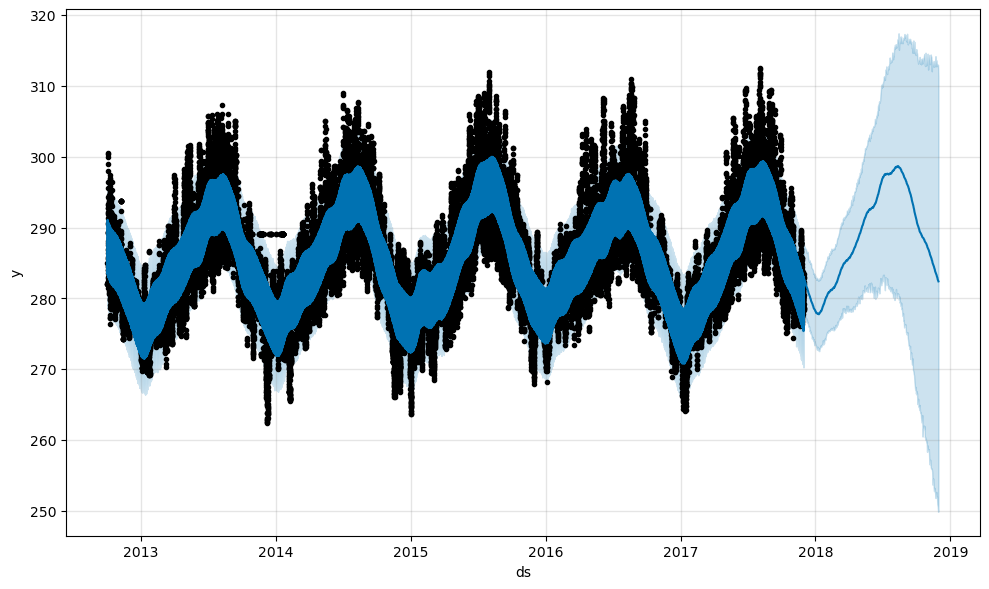

In [14]:
# Plotting the forecast
fig = model.plot(forecast)
fig.show()


C:\Users\mdipa\AppData\Local\Temp\ipykernel_17060\981025534.py:3: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



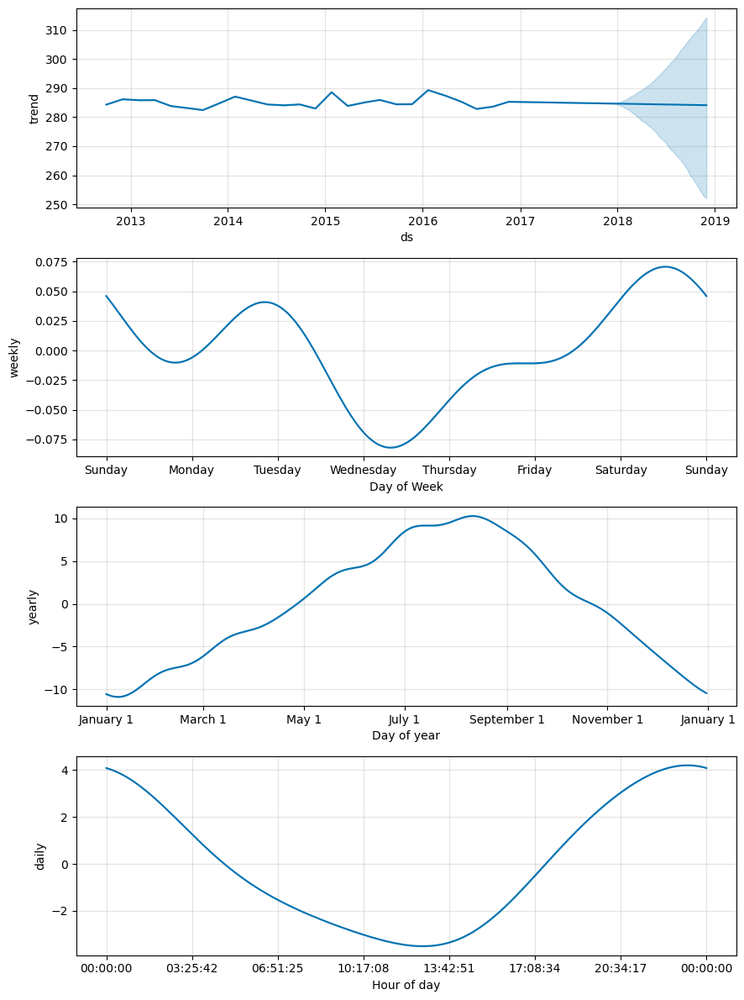

In [15]:
# Plotting the forecast components
fig2 = model.plot_components(forecast)
fig2.show()

### Thus we can make predictions for different cities for tempereture dataset and also for the other datasets like humidity,wind_speed etc.